In [1]:
# importing packages
import numpy as np
import pandas as pd
import dateutil
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import geopandas as gpd
import spacy
import re
import descartes
from matplotlib import cm
import colorsys
from matplotlib import colors
from matplotlib import cm
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from matplotlib.gridspec import GridSpec
import matplotlib.ticker as ticker
import matplotlib.cm as cm
import pickle

# Setting global params for Matplotlib font
mpl.rc('text', usetex=True)
font = {'family':'serif', 'size':12}
mpl.rc('font', **font)




In [2]:
organisation_list_UK = ["Attorney General's Office", "Cabinet Office", "Department for Business, Energy and Industrial Strategy", "Department for Digital, Culture, Media and Sport", "Department for Education", "Department for Environment, Food and Rural Affairs",  "Department for International Development", "Department for International Trade", "Department for Transport", "Department for Work and Pensions", "Department of Health and Social Care", "Foreign and Commonwealth Office", "HM Treasury", "Home Office", "Ministry of Defence", "Ministry of Housing, Communities and Local Government", "Ministry of Justice", "Northern Ireland Office",# "Government Digital Service" # part of Cabinet office, should it also be part here?
]

organisation_list_Germany = ["Attorney General's Office", "Cabinet Office", "Department for Business, Energy & Industrial Strategy", "Department for Digital, Culture, Media and Sport", "Department for Education", "Department for Environment Food and Rural Affairs", "Department for International Development", "Department for International Trade", "Department for Transport", "Department for Work and Pensions", "Department of Health and Social Care", "Foreign and Commonwealth Office", "HM Treasury", "Home Office", "Ministry of Defence", "Ministry of Housing, Communities and Local Government", "Ministry of Justice", "Northern Ireland Office",# "Government Digital Service" # part of Cabinet office, should it also be part here?
]

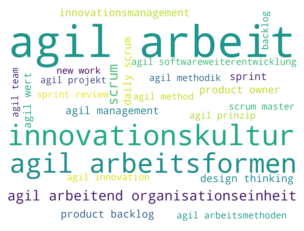

<Figure size 936x1080 with 0 Axes>

In [3]:
# Word Cloud for Germany
with open("../2_Data_Preprocessing/searchterms_de_eng_lemma.pickle", "rb") as file:
    searchterms_de_eng_lemma = pickle.load(file)

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")
df = df[df.country == 'Germany']
df = df[df.level == 'Federal']


dict_count = {}

for term in searchterms_de_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])


df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]

# Plotting wordcloud for Germany

d = {}
for a, x in df_count.values:
    d[a] = x

import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud(width=2000, height=1500, max_font_size=300, min_font_size=50, max_words=60, background_color="white", colormap="viridis")
wordcloud.generate_from_frequencies(frequencies=d)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
#plt.title('Germany', fontsize=20)
plt.axis("off")
plt.figure(figsize=(2^15,2^13))
plt.show()
wordcloud.to_file("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/wordcloud_germany_ministries.pdf")

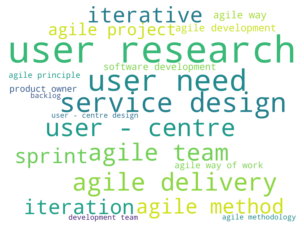

<Figure size 936x1080 with 0 Axes>

In [4]:
# word cloud for UK

with open("../2_Data_Preprocessing/searchterms_eng_lemma.pickle", "rb") as file:
    searchterms_eng_lemma= pickle.load(file)

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")




df = df[df.country == "UK"]
df = df[df['Organisation'].isin(organisation_list_UK)]

dict_count = {}

for term in searchterms_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])


df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]

# Plotting wordcloud for Britain

d = {}
for a, x in df_count.values:
    d[a] = x

import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud(width=2000, height=1500, max_font_size=300, min_font_size=50, max_words=60, background_color="white", colormap="viridis")
wordcloud.generate_from_frequencies(frequencies=d)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
#plt.title('UK', fontsize=20)
plt.axis("off")
plt.figure(figsize=(2^15,2^13))
plt.show()
wordcloud.to_file("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/wordcloud_uk_ministries.pdf")


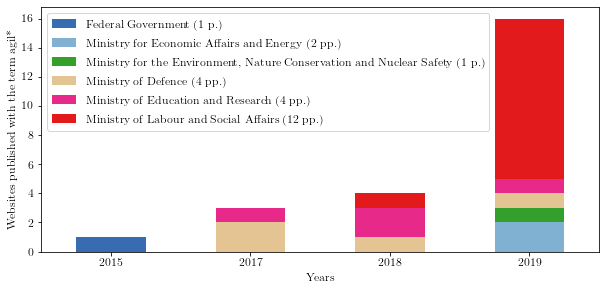

In [5]:
###### Comparing different Ministries in Germany
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['level'] == 'Federal']
df["Websites published with the term agil*"] = 1
df = df[['Organisation', 'Year', "Websites published with the term agil*"]]


df2 = df.groupby(['Organisation', "Year"]).count()
df2.reset_index(inplace=True)

# adding counts
for organisation in df.Organisation.unique():
    df_sub = df2[df2['Organisation'] == organisation]
    if df_sub['Websites published with the term agil*'].sum() ==1:
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " p.)"])
    else: 
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " pp.)"])
    df2["Organisation"].replace({organisation : other}, inplace=True)




pivot_df = df2.pivot(index='Year', columns="Organisation", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
pivot_df.append(pd.DataFrame([(0,0,0,0,0)], index=["2016"]))

colors=['#386CB0', "#80B1D3","#33A02C",'#E5C494','#E7298A','#E31A1C']

pivot_df.plot.bar(stacked=True, color=colors, figsize=(10,4.5))
#plt.title('Websites Published of German Federal Ministries', fontsize=20)
plt.legend(ncol=1)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.xticks(rotation=0)
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/germany_ministries.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

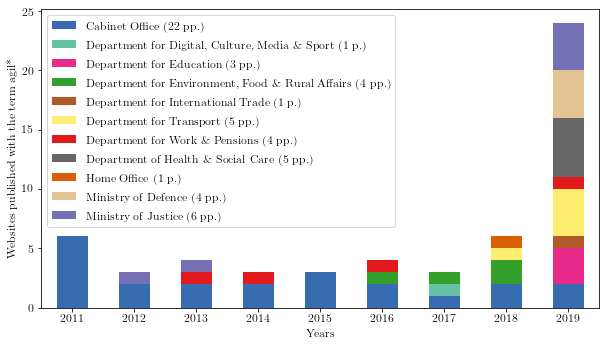

In [6]:
###### Comparing different Ministries in the uK
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['level'] == 'General']
df = df[df.Organisation.isin(organisation_list_UK)]
df["Websites published with the term agil*"] = 1
df = df[['Organisation', 'Year', "Websites published with the term agil*"]]
df['Organisation'] = df['Organisation'].str.replace('and', '\&')

df2 = df.groupby(['Organisation', "Year"]).count()
df2.reset_index(inplace=True)

# adding counts
for organisation in df.Organisation.unique():
    df_sub = df2[df2['Organisation'] == organisation]
    if df_sub['Websites published with the term agil*'].sum() ==1:
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " p.)"])
    else: 
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " pp.)"])
    df2["Organisation"].replace({organisation : other}, inplace=True)





# # everything with less then a certain number of pages will fall under "other"
# total_number = 5

# other = "".join(["other (less then ", str(total_number), " pages published)"])
# for organisation in df2['Organisation']:
#     df_sub = df2[df2['Organisation'] == organisation]
#     if df_sub['Websites published with the term agil*'].sum() < total_number:
#         df2["Organisation"].replace({organisation : other}, inplace=True)

# df2 = df2.groupby(['Organisation', "Year"]).sum()
# df2.reset_index(inplace=True)


pivot_df = df2.pivot(index='Year', columns="Organisation", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

#sns.color_palette("Blues")
#colors = sns.cubehelix_palette(13, start=-0.3, rot=-1.8, reverse=True).as_hex()
#colors =sns.choose_colorbrewer_palette(data_type='q')
#colors = sns.color_palette('hls', 13).as_hex()
#colors = sns.choose_colorbrewer_palette('q')
colors= ['#386CB0','#66C2A5','#E7298A',"#33A02C",'#B15928','#FFED6F','#E31A1C','#666666','#D95F02','#E5C494','#7570B3',]
pivot_df.plot.bar(stacked=True, color=colors, figsize=(10,5.5))
#plt.title('Websites Published of British Government Organisations', fontsize=20)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.legend(ncol=1)
plt.xticks(rotation=0)
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/british_ministries_over_time.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

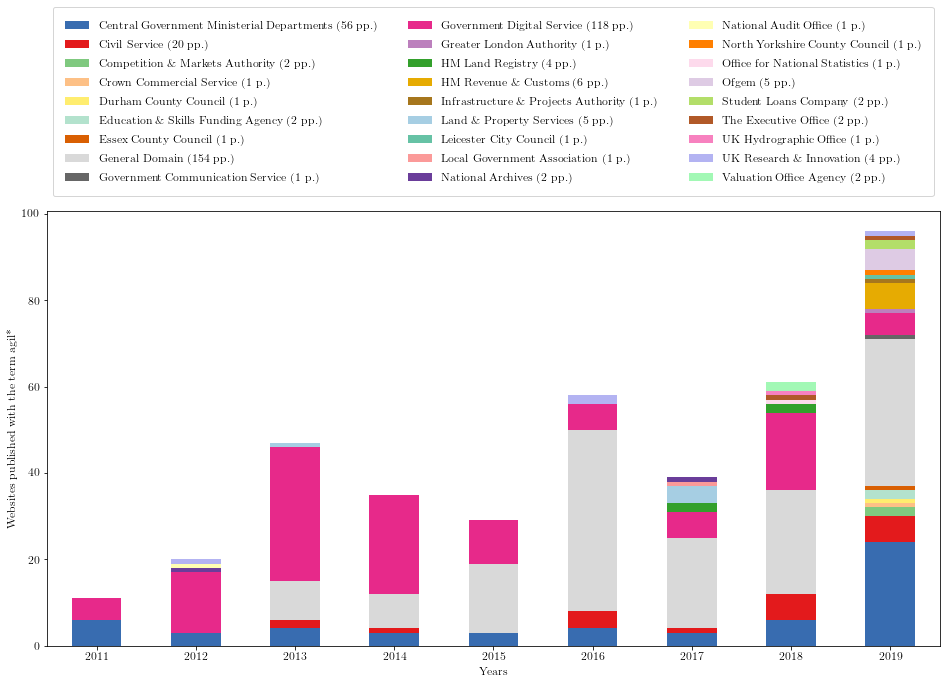

In [68]:
###### Comparing different Organisations in the UK
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['level'] == 'General']
#df = df[df.Organisation.isin(organisation_list_UK)]
df["Websites published with the term agil*"] = 1
df = df[['Organisation', 'Year', "Websites published with the term agil*"]]
#df['Organisation'] = df['Organisation'].str.replace('&', '\&')

df2 = df.groupby(['Organisation', "Year"]).count()
df2.reset_index(inplace=True)

# renaming all ministries to federal ministry
for ministry in organisation_list_UK:
    df2['Organisation'].replace({ministry:'Central Government Ministerial Departments'}, inplace=True)

# adding counts
for organisation in df2.Organisation.unique():
    df_sub = df2[df2['Organisation'] == organisation]
    if df_sub['Websites published with the term agil*'].sum() ==1:
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " p.)"])
    else: 
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " pp.)"])
    df2["Organisation"].replace({organisation : other}, inplace=True)



df2['Organisation'] = df2['Organisation'].str.replace(' and ', ' \& ')
df2['Organisation'] = df2['Organisation'].str.replace(' For ', ' for ')

df2 = df2.groupby(['Organisation', "Year"]).sum()
df2.reset_index(inplace=True)
df_uk_level = df2

pivot_df = df2.pivot(index='Year', columns="Organisation", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

#sns.color_palette("Blues")
#colors = sns.cubehelix_palette(13, start=-0.3, rot=-1.8, reverse=True).as_hex()
#colors =sns.choose_colorbrewer_palette(data_type='q')
#colors = sns.color_palette('hls', 29, desat=0.5).as_hex()
colors = [ "#386CB0", "#E31A1C",  "#7FC97F", "#FDC086", "#FFED6F","#B3E2CD",  "#D95F02", "#D9D9D9",    "#666666", "#E7298A", "#BC80BD", "#33A02C", "#E6AB02", "#A6761D", "#A6CEE3",  "#66C2A5",    "#FB9A99", "#6A3D9A", "#FFFFB3", "#FF7F00", "#FDDAEC", "#DECBE4", "#B3DE69", "#B15928", "#F781BF",  "#B3B3F2", 
      "#A2F8B5",  ]


#colors = sns.choose_colorbrewer_palette('q')
pivot_df.plot.bar(stacked=True, color=colors, figsize=(16,8))
#plt.title('Websites Published of British Government Organisations', fontsize=20)
plt.xlabel('Years')
plt.xticks(rotation=0)
plt.ylabel('Websites published with the term agil*')
plt.legend(borderpad=1, ncol=3, mode="expand", bbox_to_anchor=(0., 1.02, 1., .102))
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/british_organisations_over_time.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

In [8]:
# General Domain
print('General Domain')
print(df_uk_level[df_uk_level['Organisation'] == 'General Domain']['Websites published with the term agil*'].sum())
print('Government Digital Service')
print(df_uk_level[df_uk_level['Organisation'] == 'Government Digital Service']['Websites published with the term agil*'].sum())
print('Central Government Ministerial Departments')
print(df_uk_level[df_uk_level['Organisation'] == 'Central Government Ministerial Departments']['Websites published with the term agil*'].sum())
print('Civil Service')
print(df_uk_level[df_uk_level['Organisation'] == 'Civil Service']['Websites published with the term agil*'].sum())
print('HM Revenue \& Customs')
print(df_uk_level[df_uk_level['Organisation'] == 'HM Revenue \& Customs']['Websites published with the term agil*'].sum())
print('Ofgem')
print(df_uk_level[df_uk_level['Organisation'] == 'Ofgem']['Websites published with the term agil*'].sum())
print('Land \& Property Services')
print(df_uk_level[df_uk_level['Organisation'] == 'Land \& Property Services']['Websites published with the term agil*'].sum())

General Domain
0
Government Digital Service
0
Central Government Ministerial Departments
0
Civil Service
0
HM Revenue \& Customs
0
Ofgem
0
Land \& Property Services
0


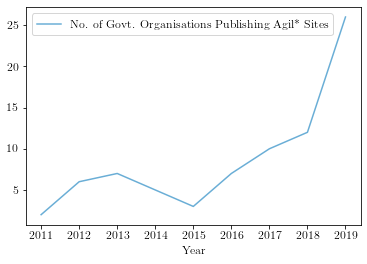

In [9]:
# plotting numbers of organisation 
#calculating number of organisation
df_count_org_uk = df.groupby("Year").agg({'Organisation': pd.Series.nunique})
#plt.figure(figsize=(5,3.5))
df_count_org_uk.rename(columns={'Organisation':'No. of Govt. Organisations Publishing Agil* Sites'}, inplace=True)


colors = sns.color_palette('Blues', 1).as_hex()
ax = sns.lineplot(data=df_count_org_uk, palette=colors)

plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/number_of_organisations_over_time_UK.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

In [10]:
# calculating individual German statate's agile breadth, depth and agile readiness index.

state_list = ["Schleswig-Holstein", "Bremen", "Hamburg", "Lower Saxony", "Thuringia", "Saxony-Anhalt", "Saxony", "Mecklenburg-Vorpommern", "Berlin", "Brandenburg", "North Rhine-Westphalia", "Rhineland-Palatinate", "Saarland", "Hesse", "Bavaria", "Baden-Wuerttemberg"]

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")

df = df[df.country == 'Germany']
df = df[df.level != "Federal"]

df_counts = df.groupby(["level"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for state in state_list:
    if state not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['level']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for state in state_list:
    if state not in df_co_terms.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3.fillna(0, inplace=True)

df3 = df3.rename(index={'Baden-Wuerttemberg': 'Baden-Württemberg'})

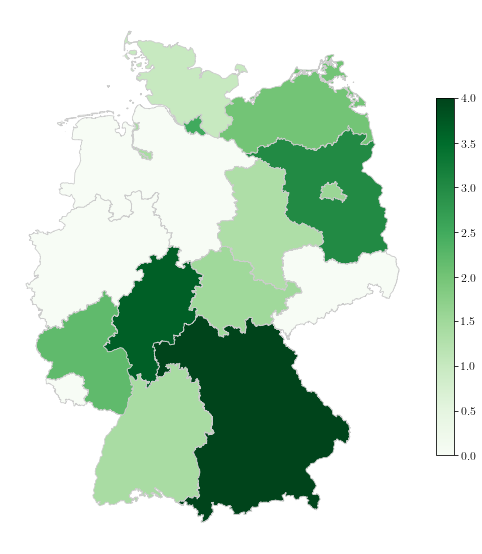

In [11]:
# plotting Germany Federal levels agile depth on map

# set the filepath and load in a shapefile
fp = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Igismap/Germany_Polygon.shp"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe

merged = map_df.set_index('name').join(df3)

# set a variable that will call whatever column we want to visualise on the map
variable = "agile_depth_absolute"
# set the range for the choropleth
vmin, vmax = merged.agile_depth_absolute.min(), merged.agile_depth_absolute.max()
# create figure and axes for Matplotlib
figlength = 5
fig, ax = plt.subplots(1, figsize=(8,20))
# create map
merged.plot(column=variable, cmap="Greens", linewidth=0.8, ax=ax, edgecolor='0.8')
ax.set_aspect(aspect=1.55)
ax.axis("off")
# add a title
#ax.set_title('     Depth of Agile Sites of German States', fontdict={'fontsize': '20', 'fontweight' : '3'})
# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Greens', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm, fraction=0.04, pad=0.04)
#cbar.set_label('Average Number of Co-Occurring Terms per Website', rotation=270, )
# saving the figure
fig.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/map_depth_export.pdf', dpi=900, bbox_inches = 'tight')


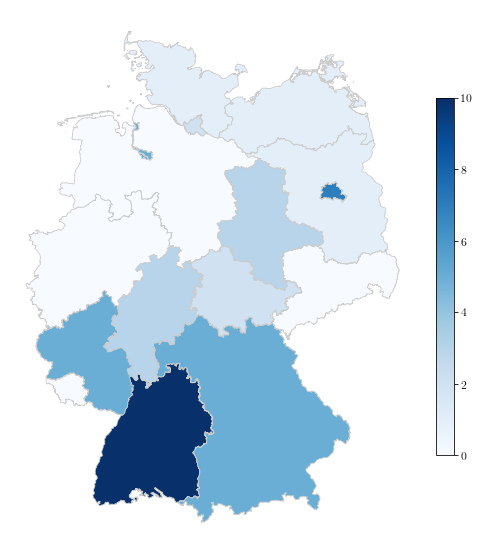

In [12]:
# plotting Germany Federal levels agile breadth on map

# set the filepath and load in a shapefile
fp = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Igismap/Germany_Polygon.shp"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe

merged = map_df.set_index('name').join(df3)

# set a variable that will call whatever column we want to visualise on the map
variable = "total_count"
# set the range for the choropleth
vmin, vmax = merged.total_count.min(), merged.total_count.max()
# create figure and axes for Matplotlib
figlength = 5
fig, ax = plt.subplots(1, figsize=(8,20))
# create map
merged.plot(column=variable, cmap="Blues", linewidth=0.8, ax=ax, edgecolor='0.8')
ax.set_aspect(aspect=1.55)
ax.axis("off")
# add a title
#ax.set_title('     Depth of Agile Sites of German States', fontdict={'fontsize': '20', 'fontweight' : '3'})
# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm, fraction=0.04, pad=0.04)
#cbar.set_label('Number of Agil* Websites Published', rotation=270)
# saving the figure
fig.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/map_breadth_export.pdf', dpi=900, bbox_inches = 'tight')

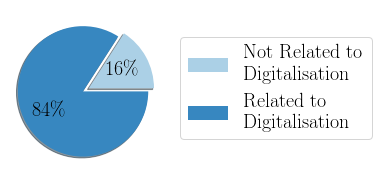

In [13]:
###### Plotting the percentage of published websites with digital overall

inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year

df['Digital'] = pd.notnull(df.digital_term)
sum = df.Digital.sum() 
sum
chart_labels = "Not Related to \n Digitalisation", 'Related to \n Digitalisation'
chart_numbers = [len(df.Digital) - sum, sum]

#dataframe = pd.DataFrame({'country': ['General'], 'not related to digitalisation': [1-percentage], 'related to digitalisation': [percentage]})
# Make square figures and axes
#plt.figure(1, figsize=(4,4))

explode = (0, 0.1)

fig, ax = plt.subplots(figsize=(6, 3), subplot_kw=dict(aspect="equal"))

colors = sns.color_palette('Blues',2).as_hex()


wedges, texts, autotexts = ax.pie(chart_numbers, autopct= lambda p : '{:.0f}\%'.format(p), shadow=True, colors=colors, explode=explode,textprops={'fontsize':50})
#plt.title('', fontsize=25)


ax.legend(wedges, chart_labels,
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1),
          fontsize=20)


#plt.suptitle('Percentage Agil* Website Publications Referring to Digitalisation', fontsize=20)
#plt.figure(figsize=(10,3))
#plt.tight_layout(pad=4)
plt.setp(autotexts, size=20, weight="bold")

#plt.show
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/digital_percentage.pdf', dpi=900, bbox_inches = 'tight',
   pad_inches = 0 )

In [14]:
# calculating German and British Federal Ministries agile breadth, depth and agile readiness index.

# For Germany
df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")



df = df[df.level == "Federal"]

df_counts = df.groupby(["Organisation"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for organisation in organisation_list_Germany:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['Organisation']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for organisation in organisation_list_Germany:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3.fillna(0, inplace=True)

df_Germany = df3
df_Germany['Country'] = "Germany"

# For Britain
df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")



df = df[df.level == "General"]
df = df[df['Organisation'].isin(organisation_list_UK)]

df_counts = df.groupby(["Organisation"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for organisation in organisation_list_UK:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['Organisation']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for organisation in organisation_list_UK:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3.fillna(0, inplace=True)

df_Britain = df3
df_Britain['Country'] = "UK"

# Joining Britain and Geramany
df_Germany_vs_Britain = pd.concat([df_Britain, df_Germany])

# Adding Ministry Types
ministry_types = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Ministry_Types_UK_Germany.csv')
df_Germany_vs_Britain = pd.merge(df_Germany_vs_Britain, ministry_types, left_index=True, right_on='Organisation')

# Calculating Agile Breadth in Comparison
df_Germany_vs_Britain['agile_breadth_in_comparison'] = (df_Germany_vs_Britain['total_count']/df_Germany_vs_Britain['total_count'].max())*100
# Calculating Agile Depth in Comparison
df_Germany_vs_Britain['agile_depth_in_comparison'] = (df_Germany_vs_Britain['agile_depth_absolute'] / df_Germany_vs_Britain['agile_depth_absolute'].max())*100
# Calculating Agile Reaadiness index in Comparison
df_Germany_vs_Britain['agile_readiness_index_absolute_in_comparison'] = df_Germany_vs_Britain['agile_depth_in_comparison'] + df_Germany_vs_Britain['agile_breadth_in_comparison']

df_Germany_vs_Britain['agile_readiness_index_in_comparison'] = (df_Germany_vs_Britain['agile_readiness_index_absolute_in_comparison'] / df_Germany_vs_Britain['agile_readiness_index_absolute_in_comparison'].max()) * 100

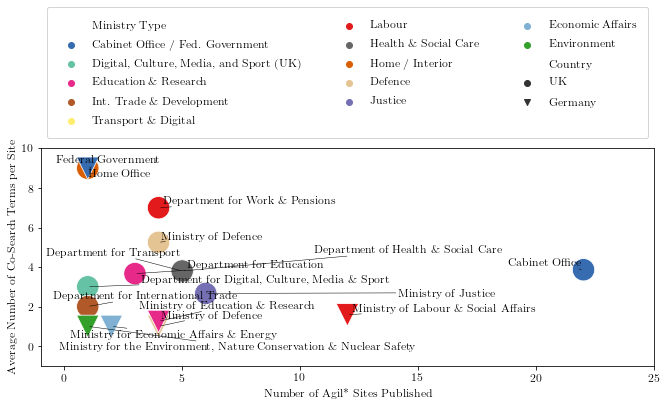

In [15]:
# With Names of Ministries
from adjustText import adjust_text
# Visualising Germen vs. British Ministries Breadth
df_Germany_vs_Britain_nozeros = df_Germany_vs_Britain[df_Germany_vs_Britain['total_count'] != 0]
df_Germany_vs_Britain_nozeros.rename(columns={"total_count":'Number of Agil* Sites Published', "agile_depth_absolute":'Average Number of Co-Search Terms per Site', 'agile_readiness_index_in_comparison':'Agile Index'}, inplace=True)

df_Germany_vs_Britain_nozeros.drop_duplicates(inplace=True)
df_Germany_vs_Britain_nozeros['Organisation'] = df_Germany_vs_Britain_nozeros['Organisation'].str.replace(' and ', ' \& ')
df_Germany_vs_Britain_nozeros['Organisation'] = df_Germany_vs_Britain_nozeros['Organisation'].str.replace(' For ', ' for ')

df_Germany_vs_Britain_nozeros.reset_index(inplace=True)

#colors = sns.color_palette('Blues',2).as_hex()
plt.figure(figsize=(11,4))
#colors = sns.color_palette('tab20', 12).as_hex()
colors = [ "#386CB0",   "#66C2A5", '#E7298A', "#B15928", "#FFED6F", "#E31A1C", "#666666", "#D95F02", "#E5C494","#7570B3",  "#80B1D3", "#33A02C"]

#"#E6AB02", "#A6761D", "#A6CEE3", "#B2DF8A", "#FB9A99", "#BEAED4", "#FDBF6F", "#FF7F00",   "#CAB2D6",  "#B3DE69",  "#FBB4AE", "#B3CDE3", "#CCEBC5", "#DECBE4", "#FED9A6", "#FFFFCC", "#FDDAEC", "#F2F2F2", "#B3E2CD",  "#CBD5E8", "#F4CAE4", "#E6F5C9", "#FFF2AE", "#F1E2CC", "#CCCCCC",    "#984EA3", "#FF7F00", "#FFFF33", "#A65628", "#F781BF", "#999999",  "#FC8D62", "#8DA0CB", "#E78AC3", "#A6D854", "#FFD92F",  "#B3B3B3",  "#FFFFB3", "#BEBADA", "#FB8072",  "#FDB462",  "#FCCDE5",  

ax = sns.scatterplot(x="Number of Agil* Sites Published", y="Average Number of Co-Search Terms per Site", hue="Ministry Type",style='Country', markers=['o','v'], data=df_Germany_vs_Britain_nozeros, s=500, palette=colors)
texts = []
for line in df_Germany_vs_Britain_nozeros.index:
     texts.append(plt.text(df_Germany_vs_Britain_nozeros['Number of Agil* Sites Published'][line], df_Germany_vs_Britain_nozeros['Average Number of Co-Search Terms per Site'][line], df_Germany_vs_Britain_nozeros['Organisation'][line], ha='center', va='center', size='medium', color='black'))
ax.set(xlim=(-1,25), ylim=(-1,10))
ax.legend(borderpad=1, ncol=3, mode="expand", bbox_to_anchor=(0., 1.02, 1., .102))
adjust_text(texts,arrowprops=dict(arrowstyle="-", color='black', lw=0.5), force_objects=(0.5, 0.5), force_text=(0.5,0.5), expand_align=(1,1))


#ax.plt.ylim(0, 100)
#ax.plt.xlim(0, 100)

fig = ax.get_figure()
fig.savefig("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/Comparison_Federal_Ministries.pdf", bbox_inches = 'tight',
    pad_inches = 0)

In [16]:
colors

['#386CB0',
 '#66C2A5',
 '#E7298A',
 '#B15928',
 '#FFED6F',
 '#E31A1C',
 '#666666',
 '#D95F02',
 '#E5C494',
 '#7570B3',
 '#80B1D3',
 '#33A02C']

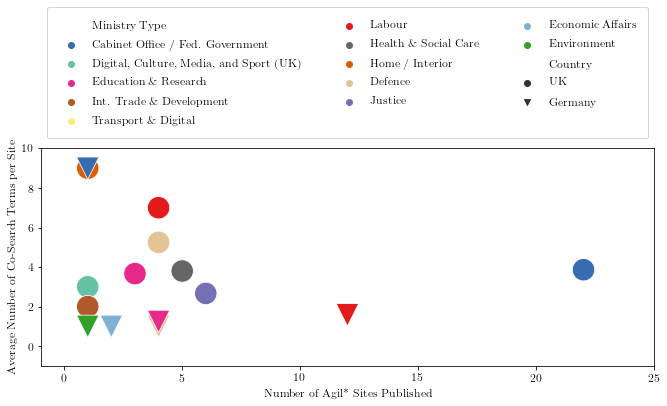

In [17]:
import random
# WithOUT Names of Ministries
from adjustText import adjust_text
# Visualising Germen vs. British Ministries Breadth
df_Germany_vs_Britain_nozeros = df_Germany_vs_Britain[df_Germany_vs_Britain['total_count'] != 0]
df_Germany_vs_Britain_nozeros.rename(columns={"total_count":'Number of Agil* Sites Published', "agile_depth_absolute":'Average Number of Co-Search Terms per Site', 'agile_readiness_index_in_comparison':'Agile Index'}, inplace=True)
df_Germany_vs_Britain_nozeros.reset_index(inplace=True)
df_Germany_vs_Britain_nozeros.drop_duplicates(inplace=True)
#colors = sns.color_palette('Blues',2).as_hex()
plt.figure(figsize=(11,4))
colors = [ "#386CB0",   "#66C2A5", '#E7298A', "#B15928", "#FFED6F", "#E31A1C", "#666666", "#D95F02", "#E5C494","#7570B3",  "#80B1D3", "#33A02C"]

ax = sns.scatterplot(x="Number of Agil* Sites Published", y="Average Number of Co-Search Terms per Site", hue="Ministry Type",style='Country', markers=['o','v'], data=df_Germany_vs_Britain_nozeros, s=500, palette=colors)
#texts = []
#for line in df_Germany_vs_Britain_nozeros.index:
#     texts.append(plt.text(df_Germany_vs_Britain_nozeros['Number of Agil* Websites Published'][line], df_Germany_vs_Britain_nozeros['Average Number of Co-Occurring Terms per Website'][line], df_Germany_vs_Britain_nozeros['Organisation'][line], ha='center', va='center', size='medium', color='black'))
ax.set(xlim=(-1,25), ylim=(-1,10))
ax.legend(borderpad=1, ncol=3, mode="expand", bbox_to_anchor=(0., 1.02, 1., .102))
#adjust_text(texts,arrowprops=dict(arrowstyle="-", color='black', lw=0.5),force_text=(1, 1.2), force_objects=(1, 0))


#ax.plt.ylim(0, 100)
#ax.plt.xlim(0, 100)

fig = ax.get_figure()
fig.savefig("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/Comparison_Federal_Ministries_without_names.pdf", bbox_inches = 'tight',
    pad_inches = 0)

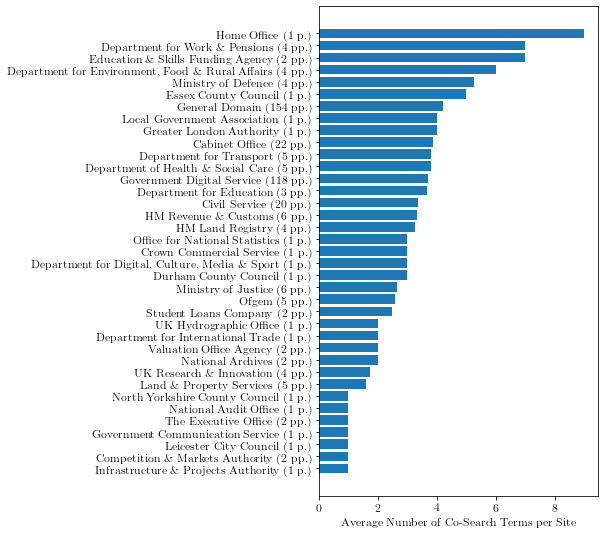

In [30]:
# calculating agile depth for british organisations alone

# For Britain
df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")



df = df[df.level == "General"]
df["Websites published with the term agil*"] = 1
#df = df[df['Organisation'].isin(organisation_list_UK)]
df['Organisation'] = df['Organisation'].str.replace(' and ', ' \& ')
df['Organisation'] = df['Organisation'].str.replace(r'\s&', ' \&')
df['Organisation'] = df['Organisation'].str.replace(' For ', ' for ')


# adding counts
for organisation in df.Organisation.unique():
    df_sub = df[df['Organisation'] == organisation]
    if df_sub['Websites published with the term agil*'].sum() ==1:
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " p.)"])
    else: 
        other = "".join([organisation, " (", str(df_sub['Websites published with the term agil*'].sum()), " pp.)"])
    df["Organisation"].replace({organisation : other}, inplace=True)


df_counts = df.groupby(["Organisation"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})


df_co_terms = df.groupby(['Organisation']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})

df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']




df3.fillna(0, inplace=True)
df3.sort_values(by=['agile_depth_absolute'], inplace=True)
df_Britain = df3

colors = [ "#BEAED4", "#7FC97F", "#FDC086", "#FFFF99", "#386CB0", "#F0027F", "#BF5B17", "#666666", "#D95F02", "#1B9E77",  "#7570B3", "#E7298A", "#66A61E", "#E6AB02", "#A6761D", "#A6CEE3", "#1F78B4", "#B2DF8A", "#33A02C", "#FB9A99", "#E31A1C", "#FDBF6F", "#FF7F00", "#CAB2D6", "#6A3D9A", "#FFFF99", "#B15928", "#FBB4AE", "#B3CDE3", "#CCEBC5", "#DECBE4", "#FED9A6", "#FFFFCC", "#E5D8BD", "#FDDAEC", "#F2F2F2", "#B3E2CD", "#FDCDAC", "#CBD5E8", "#F4CAE4", "#E6F5C9", "#FFF2AE", "#F1E2CC", "#CCCCCC", "#E41A1C", "#377EB8", "#4DAF4A", "#984EA3", "#FF7F00", "#FFFF33", "#A65628", "#F781BF", "#999999", "#66C2A5", "#FC8D62", "#8DA0CB", "#E78AC3", "#A6D854", "#FFD92F", "#E5C494", "#B3B3B3", "#8DD3C7", "#FFFFB3", "#BEBADA", "#FB8072", "#80B1D3", "#FDB462", "#B3DE69", "#FCCDE5", "#D9D9D9", "#BC80BD", "#CCEBC5", "#FFED6F"]

#fig, ax = plt.subplots()
plt.figure(figsize=(5,9))
plt.barh(y = df_Britain.index, width=df_Britain.agile_depth_absolute)
plt.xlabel('Average Number of Co-Search Terms per Site')
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/average_number_of_co_terms_british_organisations.pdf',  bbox_inches = 'tight',
    pad_inches = 0 )

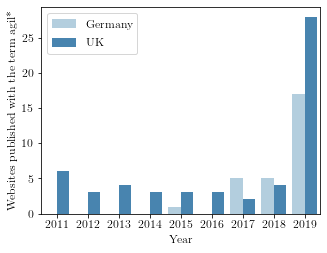

In [19]:
# Plotting German vs British Ministry Entries over time
# loading file
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
# Adding Ministry Types
ministry_types = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Ministry_Types_UK_Germany.csv')
df = pd.merge(df, ministry_types, left_on='Organisation', right_on='Organisation')
# selecting Federal and General
selection = ['Federal', 'General']
df = df[(df.level.isin(selection))]
df.rename(columns={'country':'Country'}, inplace=True)
df["Websites published with the term agil*"] = 1
df = df[['Ministry Type', 'Country', 'Year', "Websites published with the term agil*"]]

# Plotting
plt.figure(figsize=(5,3.8))
ax = sns.countplot(x='Year', hue='Country', data=df, palette='Blues')
plt.ylabel('Websites published with the term agil*')
plt.legend(loc='upper left')
ax.set_xticklabels(ax.get_xticklabels(),rotation=0)
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/british_vs_German_federal_ministries_over_time.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

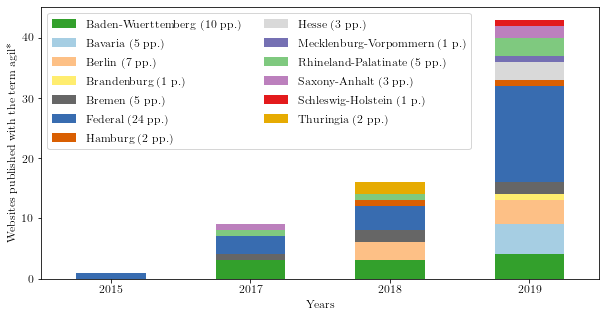

In [20]:
###### Comparing different levels in Germany over time
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['country'] == 'Germany']
df["Websites published with the term agil*"] = 1
df = df[['level', 'Year', "Websites published with the term agil*"]]
#df['Organisation'] = df['Organisation'].str.replace('&', '\&')

df2 = df.groupby(['level', "Year"]).count()
df2.reset_index(inplace=True)



# adding counts
for level in df2.level.unique():
    df_sub = df2[df2['level'] == level]
    if df_sub['Websites published with the term agil*'].sum() ==1:
        other = "".join([level, " (", str(df_sub['Websites published with the term agil*'].sum()), " p.)"])
    else: 
        other = "".join([level, " (", str(df_sub['Websites published with the term agil*'].sum()), " pp.)"])
    df2["level"].replace({level : other}, inplace=True)

# everything with less then a certain number of pages will fall under "other"
# total_number = 5

# other = "".join(["other (less then ", str(total_number), " pages published)"])
# for organisation in df2['Organisation']:
#     df_sub = df2[df2['Organisation'] == organisation]
#     if df_sub['Websites published with the term agil*'].sum() < total_number:
#         df2["Organisation"].replace({organisation : other}, inplace=True)

# df2 = df2.groupby(['Organisation', "Year"]).sum()
# df2.reset_index(inplace=True)


pivot_df = df2.pivot(index='Year', columns="level", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

#sns.color_palette("Blues")
#colors = sns.cubehelix_palette(13, start=-0.3, rot=-1.8, reverse=True).as_hex()
#colors =sns.choose_colorbrewer_palette(data_type='q')
#colors = sns.color_palette('tab20b', 13).as_hex()
colors = [  "#33A02C", "#A6CEE3",  "#FDC086", "#FFED6F", "#666666", "#386CB0","#D95F02", "#D9D9D9", "#7570B3", "#7FC97F", "#BC80BD", '#E31A1C', "#E6AB02"]

#"#A6761D","#386CB0", "#E31A1C",   "#FDC086", "#FFED6F", "#666666", "#D95F02", "#D9D9D9", "#7570B3", "#E7298A", "#BC80BD", "#E6AB02", "#A6761D"]
#"#A6CEE3",     "#FB9A99", "#6A3D9A", "#FFFFB3","#A6CEE3",    "#FB9A99", "#6A3D9A", "#FFFFB3","#66C2A5",
pivot_df.plot.bar(stacked=True, color=colors,figsize=(10,5))
#plt.title('Websites Published of British Government Organisations', fontsize=20)
plt.xlabel('Years')
plt.xticks(rotation=0)
plt.ylabel('Websites published with the term agil*')
plt.legend(ncol=2)
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/german_levels_over_time.pdf', dpi=900, bbox_inches = 'tight', pad_inches = 0 )

In [21]:
colors

['#33A02C',
 '#A6CEE3',
 '#FDC086',
 '#FFED6F',
 '#666666',
 '#386CB0',
 '#D95F02',
 '#D9D9D9',
 '#7570B3',
 '#7FC97F',
 '#BC80BD',
 '#E31A1C',
 '#E6AB02']

In [22]:
print('Federal Ministries')
print(df2[df2['level'] == 'Federal']['Websites published with the term agil*'].sum())
print('Baden Wuerttemberg')
print(df2[df2['level'] == 'Baden-Wuerttemberg']['Websites published with the term agil*'].sum())
print('Bavaria')
print(df2[df2['level'] == 'Bavaria']['Websites published with the term agil*'].sum())
print('Berlin')
print(df2[df2['level'] == 'Berlin']['Websites published with the term agil*'].sum())
print('Bremen')
print(df2[df2['level'] == 'Bremen']['Websites published with the term agil*'].sum())

Federal Ministries
0
Baden Wuerttemberg
0
Bavaria
0
Berlin
0
Bremen
0


In [23]:
###### Comparing different levels in Germany over time
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['country'] == 'UK']
df = df[df['Organisation'] == 'General Domain']
df.describe()

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,Unnamed: 0.1.1.1,date7,co_searchterms_nr,Year
count,154.000000,154.000000,154.000000,0.0,4.100000e+01,154.000000,154.000000
mean,200.064935,200.064935,1243.811688,NaN,2.017078e+13,4.207792,2016.727273
std,126.000450,126.000450,936.344099,NaN,2.430106e+10,3.237193,1.753699
min,0.000000,0.000000,3.000000,NaN,2.013040e+13,1.000000,2013.000000
25%,107.500000,107.500000,603.500000,NaN,2.015041e+13,2.000000,2016.000000
50%,225.500000,225.500000,1189.000000,NaN,2.019020e+13,3.000000,2017.000000
75%,309.750000,309.750000,1803.000000,NaN,2.019020e+13,6.000000,2018.000000
max,386.000000,386.000000,4472.000000,NaN,2.019110e+13,15.000000,2019.000000


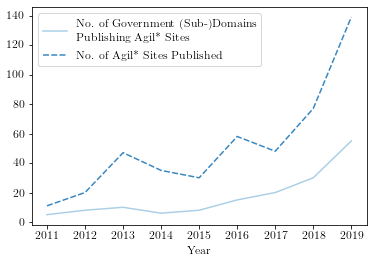

In [24]:
# calculating number of organisations over time
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"

df_in =pd.read_csv(inputFileName, parse_dates=["final_date"])

# number of organisations
df = df_in
df.sub_domain.fillna(df.domain, inplace=True)

df.rename(columns={"sub_domain":'Domain'}, inplace=True)

df['Year'] = df['final_date'].dt.year

df = df.groupby("Year").agg({'Domain': pd.Series.nunique})

# number of websites
df_sites = df_in.groupby('Year').count()

# number of of co_searchterms
df_co_searchterms = df_in.groupby('Year').mean()



df['No. of Agil* Sites Published'] = df_sites['id']
#df['Avg. No. of Co-Occuring Terms per Site'] = df_co_searchterms.co_searchterms_nr
df.rename(columns={'Domain':'No. of Government (Sub-)Domains \n Publishing Agil* Sites'}, inplace=True)
# plotting
#plt.figure(figsize=(5,3.5))
colors = sns.color_palette('Blues', 2).as_hex()
ax = sns.lineplot(data=df, palette=colors)
#plt.ylabel('Number of government domains')
#ax.set_xticklabels(ax.get_xticklabels(),rotation=45)
#plt.legend(loc='upper left')
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/number_of_sites_and_organisations_over_time.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )



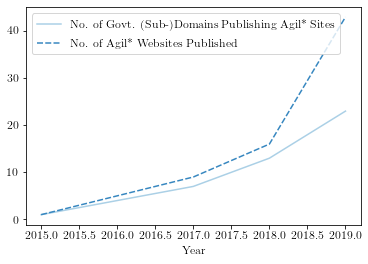

In [25]:
# calculating number of organisations over time GERMANY
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"

df_in =pd.read_csv(inputFileName, parse_dates=["final_date"])

df_in = df_in[df_in.country == "Germany"]
# number of organisations
df = df_in
df.sub_domain.fillna(df.domain, inplace=True)

df.rename(columns={"sub_domain":'Domain'}, inplace=True)

df['Year'] = df['final_date'].dt.year

df = df.groupby("Year").agg({'Domain': pd.Series.nunique})

# number of websites
df_sites = df_in.groupby('Year').count()

# number of of co_searchterms
df_co_searchterms = df_in.groupby('Year').mean()



df['No. of Agil* Websites Published'] = df_sites['id']
#df['Avg. No. of Co-Search Terms per Site'] = df_co_searchterms.co_searchterms_nr
df.rename(columns={'Domain':'No. of Govt. (Sub-)Domains Publishing Agil* Sites'}, inplace=True)
# plotting
#plt.figure(figsize=(5,3.5))
colors = sns.color_palette('Blues', 2).as_hex()
ax = sns.lineplot(data=df, palette=colors)
#plt.ylabel('Number of government domains')
#ax.set_xticklabels(ax.get_xticklabels(),rotation=45)
#plt.legend(loc='upper left')
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/number_of_sites_and_organisations_over_time_Germany.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )


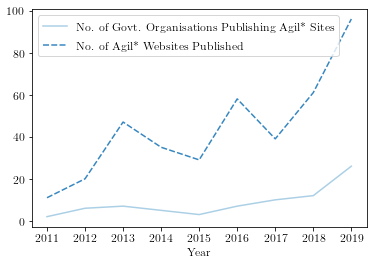

In [26]:
# calculating number of organisations over time UK
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"

df_in =pd.read_csv(inputFileName, parse_dates=["final_date"])

df_in = df_in[df_in.country == "UK"]
# number of organisations
df = df_in
df.sub_domain.fillna(df.domain, inplace=True)

df.rename(columns={"sub_domain":'Domain'}, inplace=True)

df['Year'] = df['final_date'].dt.year

df = df.groupby("Year").agg({'Organisation': pd.Series.nunique})

df.rename(columns={'Organisation':'No. of Govt. Organisations Publishing Agil* Sites'}, inplace=True)



# number of websites
df_sites = df_in.groupby('Year').count()

# number of of co_searchterms
df_co_searchterms = df_in.groupby('Year').mean()



df['No. of Agil* Websites Published'] = df_sites['id']
#df['Avg. No. of Co-Occuring Terms per Site'] = df_co_searchterms.co_searchterms_nr
# plotting
#plt.figure(figsize=(5,3.5))
colors = sns.color_palette('Blues', 2).as_hex()
ax = sns.lineplot(data=df, palette=colors)
#plt.ylabel('Number of government domains')
#ax.set_xticklabels(ax.get_xticklabels(),rotation=45)
#plt.legend(loc='upper left')
plt.savefig('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/visualisations/number_of_sites_and_organisations_over_time_UK.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

In [27]:
# calculating percentage of blog entries
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"

df =pd.read_csv(inputFileName, parse_dates=["final_date"])
df = df[df.level=='General']
total = df.shape[0]
blog = df[df.sub_domain.str.contains('blog')].shape[0]
print(blog/total)

0.4090909090909091


In [28]:
# calculating agile depth over time
'''
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])

df['Year'] = df['final_date'].dt.year
df_counts = df.groupby(["Year"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for year in df.Year.unique():
    if year not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [year], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])


df_co_terms = df.groupby(['Year']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for year in df.Year.unique():
    if year not in df_co_terms.index:
        row_df = pd.DataFrame([[0]], index = [year], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])

df6 = pd.concat([df_counts, df_co_terms], axis=1)



df6['Average Number of Co-Occurring Terms per Website'] = df6['total_co_searchterms_nr'] / df6['total_count']

# plotting
plt.figure(figsize=(5,3.5))
ax = sns.countplot(x='Year', hue='Average Numbe of Co-Occuring Terms per Website', data=df6, palette='Blues')
plt.ylabel('Average Numbe of Co-Occuring Terms per Website')
plt.legend(loc='upper left')
'''

'\ninputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"\ndf=pd.read_csv(inputFileName, parse_dates=["final_date"])\n\ndf[\'Year\'] = df[\'final_date\'].dt.year\ndf_counts = df.groupby(["Year"]).count()\ndf_counts = df_counts[["id"]]\ndf_counts = df_counts.rename(columns={"id":"total_count"})\nfor year in df.Year.unique():\n    if year not in df_counts.index:\n        row_df = pd.DataFrame([[0]], index = [year], columns=[\'total_count\'])\n        df_counts = pd.concat([row_df, df_counts])\n\n\ndf_co_terms = df.groupby([\'Year\']).sum()\ndf_co_terms = df_co_terms[["co_searchterms_nr"]]\ndf_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})\nfor year in df.Year.unique():\n    if year not in df_co_terms.index:\n        row_df = pd.DataFrame([[0]], index = [year], columns=[\'total_co_searchterms_nr\'])\n        df_co_terms = pd.concat([row_df, 